In [1]:
# 1. Data Prep (get data into numeric form + create features)
# 2. Scale the data
# 3. PCA (Optional, not always a good idea)
# 4. Elbow method
# 5. Kmeans(with X-feat or PCA-feat, never both)
# 6. Make sense of clusters using python skills, if no sense, go back to 5.

In [2]:
# Importing libraries:

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.pipeline import make_pipeline
import numpy as np
from sklearn.cluster import KMeans
from yellowbrick.cluster import KElbowVisualizer
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import os

In [76]:
# Importing our dataset

path = os.getcwd()

df = pd.read_csv(path + "/data/pgaTourData.csv")

In [77]:
df

,Player Name,Rounds,Fairway Percentage,Year,Avg Distance,gir,Average Putts,Average Scrambling,Average Score,Points,Wins,Top 10,Average SG Putts,Average SG Total,SG:OTT,SG:APR,SG:ARG,Money
0,Henrik Stenson,60.0,75.19,2018,291.5,73.51,29.93,60.67,69.617,868,NaN,5.0,-0.207,1.153,0.427,0.960,-0.027,"$2,680,487"
1,Ryan Armour,109.0,73.58,2018,283.5,68.22,29.31,60.13,70.758,"1,006",1.0,3.0,-0.058,0.337,-0.012,0.213,0.194,"$2,485,203"
2,Chez Reavie,93.0,72.24,2018,286.5,68.67,29.12,62.27,70.432,"1,020",NaN,3.0,0.192,0.674,0.183,0.437,-0.137,"$2,700,018"
3,Ryan Moore,78.0,71.94,2018,289.2,68.80,29.17,64.16,70.015,795,NaN,5.0,-0.271,0.941,0.406,0.532,0.273,"$1,986,608"
4,Brian Stuard,103.0,71.44,2018,278.9,67.12,29.11,59.23,71.038,421,NaN,3.0,0.164,0.062,-0.227,0.099,0.026,"$1,089,763"
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2307,Carl Paulson,NaN,NaN,2012,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"$16,943"
2308,Peter Tomasulo,NaN,NaN,2012,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"$12,827"
2309,Marc Turnesa,NaN,NaN,2010,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"10,159"
2310,Jesper Parnevik,NaN,NaN,2010,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"9,165"


In [78]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2312 entries, 0 to 2311
Data columns (total 18 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Player Name         2312 non-null   object 
 1   Rounds              1678 non-null   float64
 2   Fairway Percentage  1678 non-null   float64
 3   Year                2312 non-null   int64  
 4   Avg Distance        1678 non-null   float64
 5   gir                 1678 non-null   float64
 6   Average Putts       1678 non-null   float64
 7   Average Scrambling  1678 non-null   float64
 8   Average Score       1678 non-null   float64
 9   Points              2296 non-null   object 
 10  Wins                293 non-null    float64
 11  Top 10              1458 non-null   float64
 12  Average SG Putts    1678 non-null   float64
 13  Average SG Total    1678 non-null   float64
 14  SG:OTT              1678 non-null   float64
 15  SG:APR              1678 non-null   float64
 16  SG:ARG

## DataPrep

In [79]:
df["Top 10"] = df["Top 10"].map({np.nan: 0, 1.0: 1, 2.0: 2, 3.0: 3, 4.0: 4, 5.0: 5, 6.0: 6, 7.0: 7, 8.0: 8, 9.0: 9,
                   10.0: 10})

In [80]:
df["Wins"] = df["Wins"].map({np.nan: 0, 1.0: 1, 2.0: 2, 3.0: 3})

In [81]:
df["Money"] = df["Money"].str.replace("$", "", regex=False)

In [82]:
df["Money"] = df["Money"].str.replace(",", "", regex=False)

In [83]:
df = df.dropna()

In [84]:
df["Money"] = df["Money"].astype(int)

/var/folders/j_/__64n8zj7cl2_v79xs0k7lpm0000gn/T/ipykernel_37667/24475352.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Money"] = df["Money"].astype(int)


In [85]:
df["Points"] = df["Points"].str.replace(",", "", regex=False).astype(int)

/var/folders/j_/__64n8zj7cl2_v79xs0k7lpm0000gn/T/ipykernel_37667/2285993943.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df["Points"] = df["Points"].str.replace(",", "", regex=False).astype(int)


In [86]:
seasons_played = df.groupby('Player Name')['Year'].nunique().reset_index(name='No Seasons')

seasons_played

,Player Name,No Seasons
0,Aaron Baddeley,9
1,Aaron Watkins,1
2,Aaron Wise,1
3,Abraham Ancer,2
4,Adam Hadwin,4
...,...,...
433,Zac Blair,4
434,Zach Johnson,9
435,Zack Miller,1
436,Zecheng Dou,1


In [87]:
df

,Player Name,Rounds,Fairway Percentage,Year,Avg Distance,gir,Average Putts,Average Scrambling,Average Score,Points,Wins,Top 10,Average SG Putts,Average SG Total,SG:OTT,SG:APR,SG:ARG,Money
0,Henrik Stenson,60.0,75.19,2018,291.5,73.51,29.93,60.67,69.617,868,0.0,5.0,-0.207,1.153,0.427,0.960,-0.027,2680487
1,Ryan Armour,109.0,73.58,2018,283.5,68.22,29.31,60.13,70.758,1006,1.0,3.0,-0.058,0.337,-0.012,0.213,0.194,2485203
2,Chez Reavie,93.0,72.24,2018,286.5,68.67,29.12,62.27,70.432,1020,0.0,3.0,0.192,0.674,0.183,0.437,-0.137,2700018
3,Ryan Moore,78.0,71.94,2018,289.2,68.80,29.17,64.16,70.015,795,0.0,5.0,-0.271,0.941,0.406,0.532,0.273,1986608
4,Brian Stuard,103.0,71.44,2018,278.9,67.12,29.11,59.23,71.038,421,0.0,3.0,0.164,0.062,-0.227,0.099,0.026,1089763
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1673,Phil Mickelson,76.0,52.66,2010,299.1,65.13,28.79,61.84,69.966,1629,1.0,5.0,-0.147,1.001,0.185,0.738,0.228,3821733
1674,John Daly,63.0,52.21,2010,305.7,65.66,29.78,53.53,71.697,97,0.0,0.0,-0.653,-0.989,0.336,-0.374,-0.298,158587
1675,Jimmy Walker,82.0,51.29,2010,292.9,65.88,29.14,58.46,70.953,554,0.0,2.0,0.252,0.093,-0.538,0.336,0.047,937987
1676,Daniel Chopra,74.0,51.27,2010,295.9,61.64,28.88,56.16,72.194,142,0.0,0.0,0.361,-1.096,-0.307,-1.070,-0.084,311405


In [88]:
df["Year"].value_counts()

2018    192
2010    192
2012    190
2017    189
2011    186
2016    184
2015    182
2013    179
2014    176
Name: Year, dtype: int64

In [89]:
adf = df.groupby('Player Name').agg({
    'Rounds': 'sum',  # Sum of rounds played
    'Fairway Percentage': 'mean',  # Average fairway percentage
    'Avg Distance': 'mean',  # Average driving distance
    'gir': 'mean',  # Greens in regulation
    'Average Putts': 'mean',  # Average putts
    'Average Scrambling': 'mean',  # Average scrambling
    'Average Score': 'mean',  # Average score
    'Points': 'sum',  # Total points
    'Wins': 'sum',  # Total wins
    'Top 10': 'sum',  # Total top 10 finishes
    'Average SG Putts': 'mean',  # Average strokes gained: putting
    'Average SG Total': 'mean',  # Average strokes gained: total
    'SG:OTT': 'mean',  # Strokes gained off-the-tee
    'SG:APR': 'mean',  # Strokes gained approach
    'SG:ARG': 'mean',  # Strokes gained around-the-green
    'Money': 'sum'  # Total earnings
}).reset_index()

In [90]:
adf = adf.merge(seasons_played, on='Player Name', how='left')

In [91]:
adf.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 438 entries, 0 to 437
Data columns (total 18 columns):
 #   Column              Non-Null Count  Dtype  
---  ------              --------------  -----  
 0   Player Name         438 non-null    object 
 1   Rounds              438 non-null    float64
 2   Fairway Percentage  438 non-null    float64
 3   Avg Distance        438 non-null    float64
 4   gir                 438 non-null    float64
 5   Average Putts       438 non-null    float64
 6   Average Scrambling  438 non-null    float64
 7   Average Score       438 non-null    float64
 8   Points              438 non-null    int64  
 9   Wins                438 non-null    float64
 10  Top 10              438 non-null    float64
 11  Average SG Putts    438 non-null    float64
 12  Average SG Total    438 non-null    float64
 13  SG:OTT              438 non-null    float64
 14  SG:APR              438 non-null    float64
 15  SG:ARG              438 non-null    float64
 16  Money   

In [19]:
# Dataprep is done... Well, actually...

#df.rename(columns{"Money": "Prize Money ($)"})

#Actually, no... It will just make the syntax harder

# We might want to choose any/or either of average putts or average SG putts but we'll come back to this, this
# is unsupervized afterall. And we'll see what the machine uses to split. 

# We might also want to drop scramble and then also filter for only one year but it doesn't seem too bad
# with how the data is distributed across years. Highest diff is  192 - 176. 

In [20]:
# Explaination of columns:
#
# Year: The year of the tournament. This is a temporal dimension that might not directly contribute to 
# performance clustering unless you're interested in changes over time.
#
# Avg Distance: Average distance of tee shots. This measures the power of a golfer's drives.
#
# gir (Greens in Regulation): The percentage of times a golfer reaches the green in the number 
# of strokes deemed standard. It's a good indicator of approach play accuracy.
#
# Average Putts: The average number of putts per round. It reflects putting efficiency.
#
# Average Scrambling: The percentage of times a player misses the green in regulation but 
# still makes par or better. It's a measure of a player's ability to recover from a poor shot.
#
# Average Score: The average score per round. It's a direct indicator of overall performance.
#
# Points: Points earned in the season, often related to the FedExCup points system.
#
# Wins: The number of wins. This is a measure of ultimate success in tournaments.
#
# Top 10: The number of top-10 finishes. Like wins, it's a measure of consistent high performance.
#
# Average SG Putts (Strokes Gained: Putting): Measures a player's putting performance relative to the 
# field. It's a more sophisticated measure than average putts because it considers the difficulty of each putt.
#
# Average SG Total: Total strokes gained across all aspects of the game. It's an overall performance metric.
#
# SG:OTT (Strokes Gained: Off-The-Tee): Measures a player's performance off the tee.
#
# SG:APR (Strokes Gained: Approach): Measures a player's performance on approach shots.
#
# SG:ARG (Strokes Gained: Around-The-Green): Measures performance on shots taken around the green, 
# excluding putts.
#
# Money: The amount of prize money won. This is another indicator of success but can also reflect 
# the prestige of tournaments won.

In [21]:
def eda_reg(d, t):
    for i in d.select_dtypes(include=["number", "float", "int"]).drop(columns=t):
        sns.regplot(data=d, y = t, x = i)
        plt.title(f'Regression of {t} on {i}')
        plt.show()
        corren = d[[t, i]].corr()
        print(f'Correlation between {t} and {i}: {corren.loc[t, i]}')

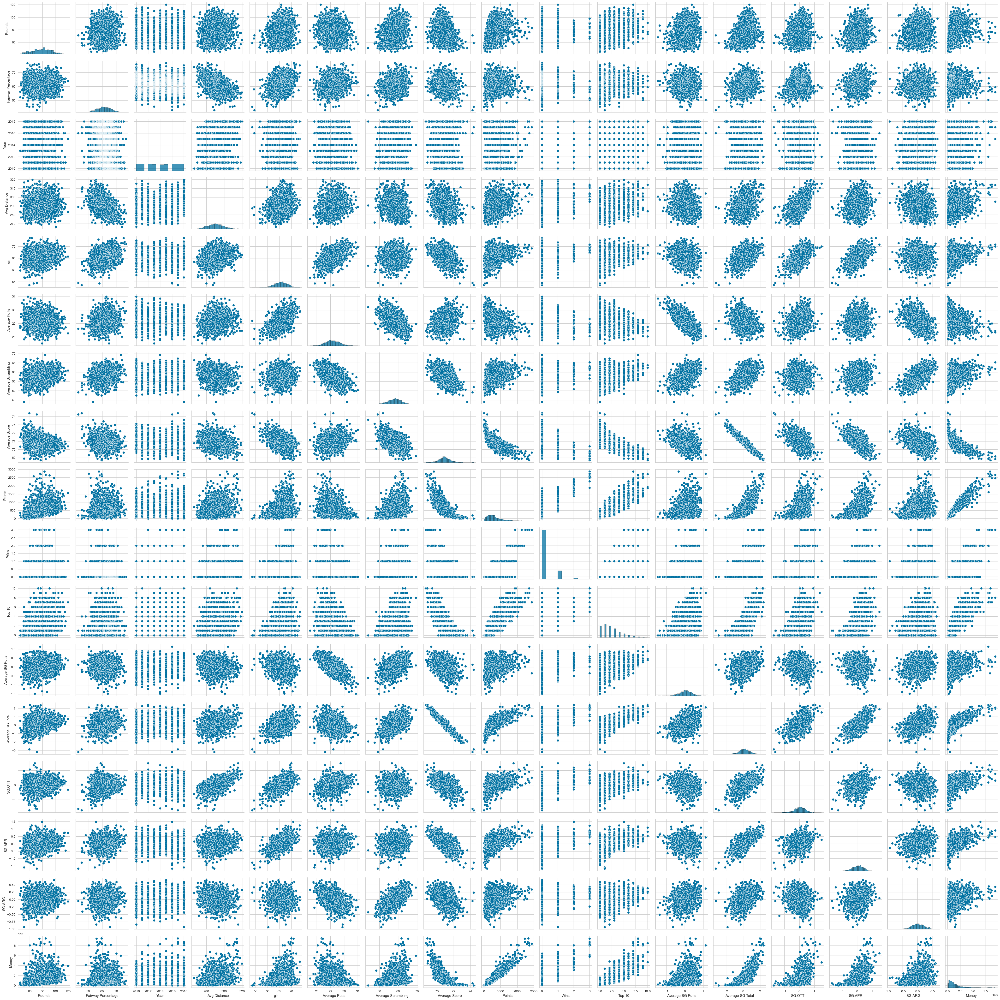

In [22]:
sns.pairplot(df.select_dtypes("number"))

## Pipeline & Choosing between PCA features or X features

In [184]:
X = adf.select_dtypes("number").copy()
X = X.drop(columns=["Rounds", "No Seasons", "Points", "Wins", "Money", "Average Score", "Top 10",
                    "Average SG Total", "SG:OTT", "SG:APR", "SG:ARG", "Average SG Putts"], axis=1)

In [185]:
X.columns

Index(['Fairway Percentage', 'Avg Distance', 'gir', 'Average Putts',
       'Average Scrambling'],
      dtype='object')

In [94]:
X

,Fairway Percentage,Avg Distance,gir,Average Scrambling,Average SG Putts,SG:OTT,SG:APR,SG:ARG
0,53.427778,293.677778,61.945556,60.074444,0.473333,-0.342667,-0.310333,0.333111
1,63.030000,277.100000,62.250000,59.530000,0.402000,-0.568000,-0.707000,0.285000
2,63.330000,302.900000,68.810000,56.280000,0.238000,0.410000,0.012000,0.042000
3,64.530000,286.250000,64.150000,59.680000,-0.238500,0.150500,-0.133000,0.017500
4,64.375000,289.600000,66.387500,59.680000,0.319750,0.075000,0.026250,0.043250
...,...,...,...,...,...,...,...,...
433,67.557500,275.150000,64.765000,63.617500,0.240000,-0.216750,-0.188750,0.186000
434,68.653333,282.144444,66.458889,60.882222,0.362222,0.052778,0.322222,0.165222
435,57.060000,299.500000,61.790000,54.260000,-0.483000,0.057000,-0.612000,-0.012000
436,54.760000,291.900000,63.720000,51.560000,-0.667000,-0.079000,-0.265000,-0.187000


In [186]:
scaler = StandardScaler()
pca = PCA()
pipe = make_pipeline(scaler, pca)

pipe.fit(X)

Pipeline(steps=[('standardscaler', StandardScaler()), ('pca', PCA())])

In [256]:
pipe["pca"].explained_variance_ratio_.cumsum()

# Eeeeh... 0.64 isn't TOO bad. Do we want to use three? 

array([0.38832551, 0.72469966])

<Axes: >

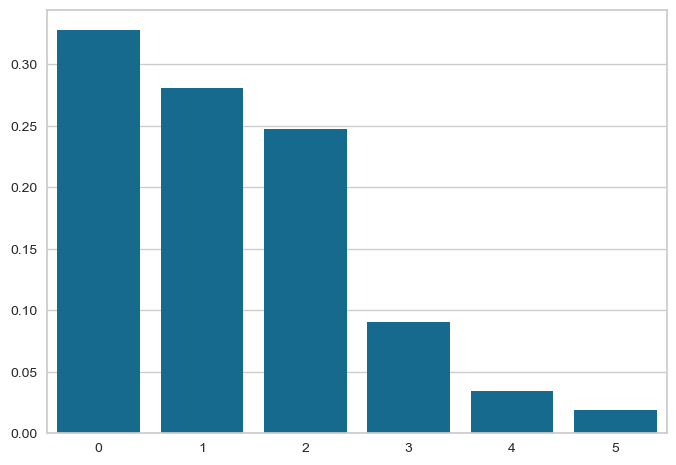

In [161]:
sns.barplot(pipe["pca"].explained_variance_ratio_)

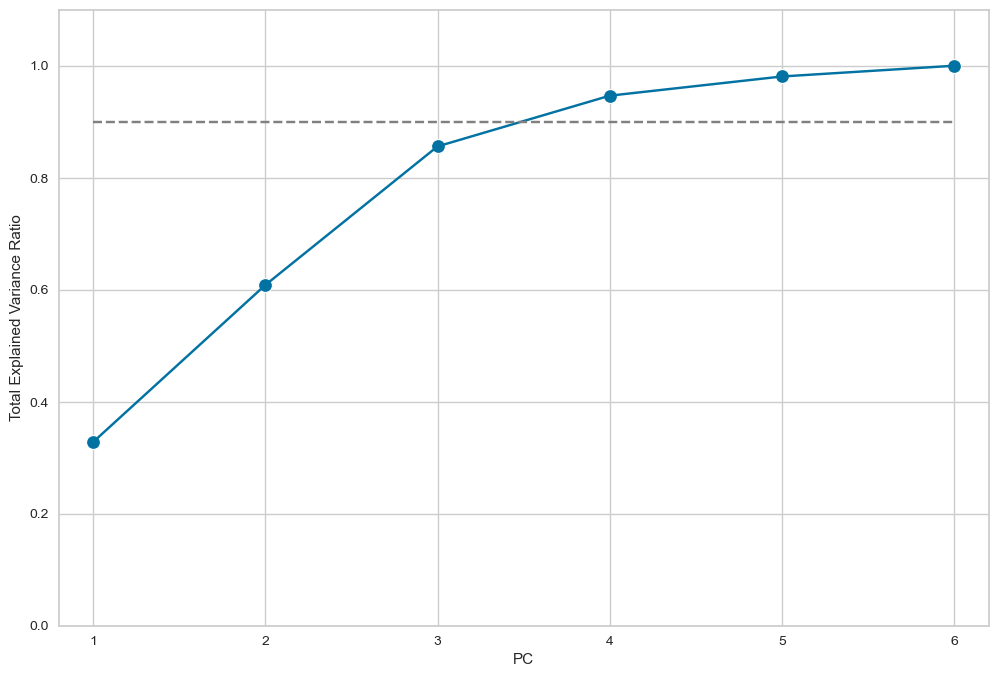

In [162]:
explained_variance = pipe['pca'].explained_variance_ratio_.cumsum()
index = [i+1 for i in range(len(explained_variance))]

fig, ax = plt.subplots(figsize=(12, 8))

sns.lineplot(x=index, y=explained_variance)
sns.scatterplot(x=index, y=explained_variance, s=100)
plt.xlim((1-0.2, len(explained_variance)+0.2))
plt.ylim((0, 1.1))
x_s, x_e = ax.get_xlim()
ax.xaxis.set_ticks(np.arange(x_s+0.2, x_e))
ax.hlines(y=0.9, xmin=1, xmax=len(explained_variance), color='gray', linestyle='--')
plt.ylabel('Total Explained Variance Ratio')
plt.xlabel('PC')
plt.show()

In [163]:
# Either 3 or 4 if we want to go the PCA route maybe even 5 to get above .9
# Let's start with two... How many clusters will we need? 

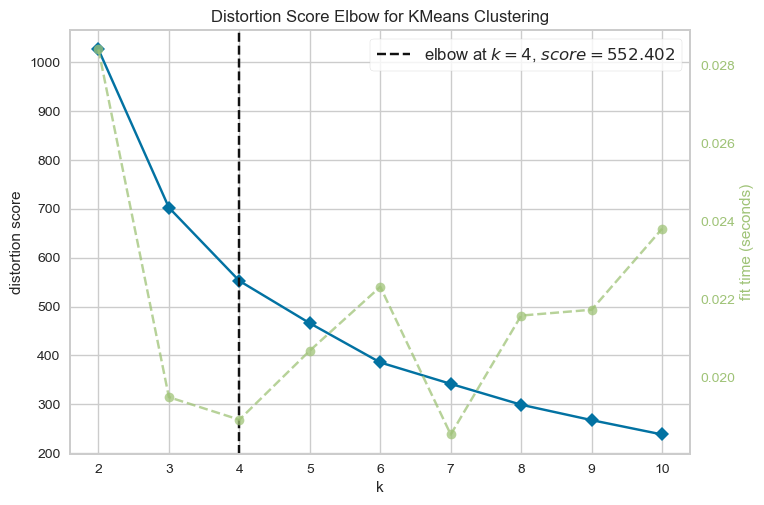

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [255]:
scaler = StandardScaler()
decomp = PCA(n_components=2)
cluster = KElbowVisualizer(KMeans(n_init=10))
pipe = make_pipeline(scaler, decomp, cluster)

pipe.fit(X)
pipe[2].show()

In [32]:
# 4 clusters with 2 PCA
# 5 clusters with 3, 4 and 5 PCA
# Good, this makes our job a little bit easier should we need to return to this. 

## Pipeline finalization: 
### 2 PCA

In [209]:
scaler = StandardScaler()
decomp = PCA(n_components=2)
cluster = KMeans(n_clusters=4, n_init=10)
pipe = make_pipeline(scaler, decomp, cluster)

pipe.fit(X)

Pipeline(steps=[('standardscaler', StandardScaler()),
                ('pca', PCA(n_components=2)),
                ('kmeans', KMeans(n_clusters=4, n_init=10))])

In [210]:
values = pipe[:2].transform(X)
pca_labels = [f"PC{idx+1}" for idx, i in enumerate(values.T)]

In [211]:
temp = adf.reset_index(drop=True).copy()

In [212]:
pcadf = pd.DataFrame(values, columns=pca_labels)

In [213]:
temp = temp.join(pcadf)

In [214]:
temp["cluster"] = pipe["kmeans"].labels_

In [215]:
temp

,Player Name,Rounds,Fairway Percentage,Avg Distance,gir,Average Putts,Average Scrambling,Average Score,Points,Wins,...,Average SG Putts,Average SG Total,SG:OTT,SG:APR,SG:ARG,Money,No Seasons,PC1,PC2,cluster
0,Aaron Baddeley,700.0,53.427778,293.677778,61.945556,28.295556,60.074444,71.008444,5103,2.0,...,0.473333,0.152444,-0.342667,-0.310333,0.333111,10419470,9,-1.892198,-2.412771,3
1,Aaron Watkins,46.0,63.030000,277.100000,62.250000,28.750000,59.530000,71.770000,126,0.0,...,0.402000,-0.589000,-0.568000,-0.707000,0.285000,217495,1,-2.271253,0.079838,2
2,Aaron Wise,90.0,63.330000,302.900000,68.810000,29.150000,56.280000,70.247000,1086,1.0,...,0.238000,0.703000,0.410000,0.012000,0.042000,3486407,1,1.301388,0.219417,1
3,Abraham Ancer,149.0,64.530000,286.250000,64.150000,28.985000,59.680000,71.398000,736,0.0,...,-0.238500,-0.203500,0.150500,-0.133000,0.017500,1839506,2,-1.204821,0.410932,2
4,Adam Hadwin,378.0,64.375000,289.600000,66.387500,28.847500,59.680000,70.768250,3207,1.0,...,0.319750,0.486250,0.075000,0.026250,0.043250,7392920,4,-0.803350,0.567110,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
433,Zac Blair,376.0,67.557500,275.150000,64.765000,28.802500,63.617500,71.106500,1631,0.0,...,0.240000,0.020000,-0.216750,-0.188750,0.186000,3266994,4,-2.623841,1.640999,2
434,Zach Johnson,803.0,68.653333,282.144444,66.458889,28.727778,60.882222,70.107444,10935,5.0,...,0.362222,0.896778,0.052778,0.322222,0.165222,27540362,9,-1.648729,1.563075,2
435,Zack Miller,86.0,57.060000,299.500000,61.790000,29.450000,54.260000,71.890000,290,0.0,...,-0.483000,-1.051000,0.057000,-0.612000,-0.012000,427341,1,0.747522,-1.828810,0
436,Zecheng Dou,53.0,54.760000,291.900000,63.720000,30.000000,51.560000,72.773000,21,0.0,...,-0.667000,-1.198000,-0.079000,-0.265000,-0.187000,90993,1,1.938354,-1.304414,0


<Axes: xlabel='PC1', ylabel='PC2'>

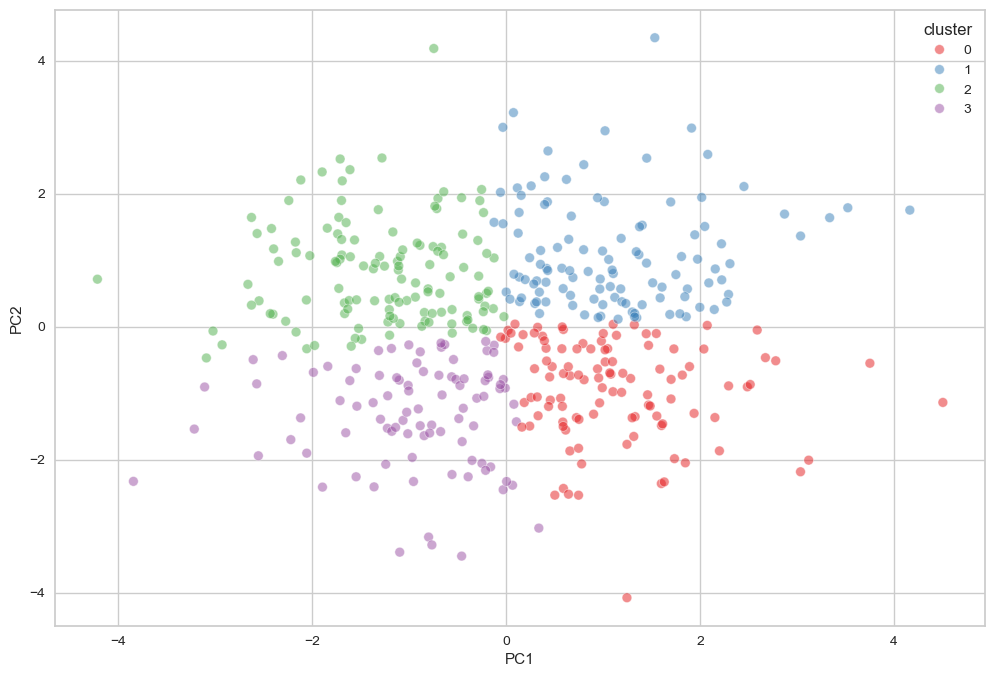

In [216]:
plt.figure(figsize=(12,8))
sns.scatterplot(data=temp, x="PC1", y="PC2", hue="cluster", alpha=0.5, palette="Set1")

In [217]:
temp.columns

Index(['Player Name', 'Rounds', 'Fairway Percentage', 'Avg Distance', 'gir',
       'Average Putts', 'Average Scrambling', 'Average Score', 'Points',
       'Wins', 'Top 10', 'Average SG Putts', 'Average SG Total', 'SG:OTT',
       'SG:APR', 'SG:ARG', 'Money', 'No Seasons', 'PC1', 'PC2', 'cluster'],
      dtype='object')

In [218]:
temp["cluster"].value_counts()

2    126
1    112
0    108
3     92
Name: cluster, dtype: int64

In [175]:
# Which players are in which cluster?

c0 = temp["cluster"] == 0
c1 = temp["cluster"] == 1
c2 = temp["cluster"] == 2
c3 = temp["cluster"] == 3

In [176]:
# c0

for i in temp.loc[c0]["Player Name"]:
    print(i)
    
# Zzzz


Aaron Watkins
Abraham Ancer
Adam Hadwin
Alex Cejka
Alex Noren
Andrew Landry
Austin Cook
Ben Crane
Ben Curtis
Ben Silverman
Bill Haas
Billy Hurley III
Blake Adams
Bob Estes
Brandt Snedeker
Brendon Todd
Brendon de Jonge
Brett Drewitt
Brian Davis
Brian Gay
Brian Harman
Brian Stuard
Bryce Molder
Chad Collins
Charlie Wi
Chris Couch
Chris DiMarco
Chris Kirk
Chris Riley
Chris Stroud
Colt Knost
Conrad Shindler
Craig Bowden
D.A. Points
D.H. Lee
Daniel Summerhays
Danny Lee
Darron Stiles
David Hearn
David Lingmerth
David Lynn
David Mathis
David Toms
Dean Wilson
Dicky Pride
Doug LaBelle II
Fabián Gómez
Freddie Jacobson
Gavin Coles
George McNeill
Graeme McDowell
Greg Chalmers
Hideki Matsuyama
Hunter Haas
Ian Poulter
J.P. Hayes
Jason Bohn
Jeev Milkha Singh
Jeff Quinney
Jerry Kelly
Jim Furyk
Jin Park
John Huh
Jon Curran
Jonathan Byrd
Jordan Spieth
Justin Leonard
Justin Rose
K.J. Choi
Ken Duke
Kevin Kisner
Kevin Na
Lee Williams
Luke Donald
Mark Hubbard
Mark Wilson
Matt Kuchar
Matt McQuillan
Michael Co

In [46]:
#Cluster 1

for i in temp.loc[c1]["Player Name"]:
    print(i)
    
# John Daly!

Adam Schenk
Alex Prugh
Alexandre Rocha
Andres Gonzales
Andrew Landry
Andrew Svoboda
Anirban Lahiri
Ben Kohles
Ben Martin
Bill Lunde
Billy Mayfair
Blayne Barber
Boo Weekley
Brad Fritsch
Brandon Hagy
Brandon Harkins
Brandt Jobe
Brendan Steele
Brett Stegmaier
Brett Wetterich
Brice Garnett
Bronson Burgoon
Byron Smith
Cameron Beckman
Cameron Percy
Carlos Ortiz
Charles Warren
Charlie Beljan
Chesson Hadley
Chris Couch
Cliff Kresge
Conrad Shindler
Corey Conners
D.J. Trahan
Davis Love III
Dawie van der Walt
Garth Mulroy
Gary Christian
Grayson Murray
Greg Owen
Harold Varner III
Harrison Frazar
Heath Slocum
Henrik Bjornstad
Henrik Norlander
Hudson Swafford
Hunter Mahan
J.J. Henry
J.J. Spaun
J.T. Poston
James Hahn
Jason Gore
Jason Kokrak
Jay Williamson
Jeff Maggert
Jeff Overton
Jhonattan Vegas
Jim Herman
John Daly
John Merrick
John Peterson
John Rollins
Joseph Bramlett
Josh Teater
Julián Etulain
Justin Hicks
Keith Mitchell
Kelly Kraft
Kent Jones
Kevin Chappell
Kevin Stadler
Kevin Tway
Kris Blanks


In [47]:
for i in temp.loc[c2]["Player Name"]:
    print(i)
    
# Bubba the driver killer
# Spieth
# PHIL MICKELSON!!
# RORY <3
# T I G E R
# STENSON

Aaron Wise
Adam Hadwin
Adam Scott
Alex Noren
Aron Price
Austin Cook
Beau Hossler
Bill Haas
Billy Horschel
Bo Van Pelt
Branden Grace
Brendon de Jonge
Brooks Koepka
Bryson DeChambeau
Bubba Watson
Bud Cauley
Byeong Hun An
C.T. Pan
Chad Campbell
Charl Schwartzel
Charles Howell III
Charley Hoffman
Chez Reavie
Chris Kirk
Daniel Berger
Dustin Johnson
Emiliano Grillo
Francesco Molinari
Gary Woodland
Graeme McDowell
Graham DeLaet
Harris English
Henrik Stenson
Hideki Matsuyama
J.B. Holmes
Jamie Lovemark
Jason Day
Jason Dufner
Jim Furyk
Jimmy Walker
Joe Durant
Joel Dahmen
John Senden
Jon Rahm
Jordan Spieth
Justin Rose
Justin Thomas
Keegan Bradley
Kenny Perry
Kevin Streelman
Kevin Sutherland
Lee Westwood
Louis Oosthuizen
Marc Leishman
Martin Laird
Matt Kuchar
Nate Lashley
Nick Watney
Pat Perez
Patrick Cantlay
Paul Casey
Peter Uihlein
Phil Mickelson
Rafa Cabrera Bello
Rickie Fowler
Rory McIlroy
Russell Henley
Russell Knox
Ryan Armour
Ryan Moore
Ryan Palmer
Sam Ryder
Sergio Garcia
Steve Stricker
Ste

In [48]:
for i in temp.loc[c3]["Player Name"]:
    print(i)

#Zzzzzz

Aaron Baddeley
Aaron Watkins
Abraham Ancer
Alex Cejka
Andres Romero
Andrew Putnam
Anthony Kim
Arjun Atwal
Ben Crane
Ben Curtis
Ben Silverman
Billy Hurley III
Blake Adams
Bob Estes
Brandt Snedeker
Brendon Todd
Brett Quigley
Brian Davis
Brian Gay
Brian Harman
Brian Stuard
Briny Baird
Bronson La'Cassie
Bryce Molder
Cameron Smith
Cameron Tringale
Camilo Villegas
Carl Pettersson
Casey Wittenberg
Chad Collins
Charlie Wi
Chris DiMarco
Chris Riley
Chris Stroud
Chris Tidland
Colt Knost
D.A. Points
Daniel Summerhays
Danny Lee
Darron Stiles
David Hearn
David Lingmerth
David Lynn
David Mathis
David Toms
Dean Wilson
Denny McCarthy
Derek Fathauer
Dicky Pride
Dominic Bozzelli
Doug LaBelle II
Erik Compton
Ernie Els
Fabián Gómez
Freddie Jacobson
Garrett Willis
Gavin Coles
Geoff Ogilvy
George McNeill
Gonzalo Fernandez-Castaño
Greg Chalmers
Hiroshi Iwata
Hunter Haas
Ian Poulter
J.J. Killeen
J.P. Hayes
James Driscoll
James Nitties
Jamie Donaldson
Jarrod Lyle
Jason Bohn
Jeev Milkha Singh
Jeff Quinney
Jerry

In [49]:
# Hypothesis: C1 will be overwhelmingly better than the other clusters in wins and money
# Long drive is hard but I believe C1 will be better in almost all estimates
# But where is stenson? C1... Of course he is. 

In [219]:
temp.pivot_table(index="cluster", 
        
        values=['Rounds', 'Fairway Percentage', 'Avg Distance',
       'gir', 'Average Putts', 'Average Scrambling', 'Average Score', 'Points', 
       'Average SG Putts', 'Average SG Total', 'SG:OTT',
       'SG:APR', 'SG:ARG', 'Money'], 
        
        aggfunc={'Rounds': "sum", 'Fairway Percentage': "mean", 'Avg Distance': "mean",
       'gir': "mean", 'Average Putts': "mean", 'Average Scrambling': "mean", 
       'Average Score': "mean", 'Points': "sum", 'Average SG Putts': "mean", 
       'Average SG Total': "mean", 'SG:OTT': "mean", 'SG:APR': "mean", 
       'SG:ARG': "mean", 'Money': "sum"})

,Average Putts,Average SG Putts,Average SG Total,Average Score,Average Scrambling,Avg Distance,Fairway Percentage,Money,Points,Rounds,SG:APR,SG:ARG,SG:OTT,gir
cluster,,,,,,,,,,,,,,
0,29.395994,-0.116325,-0.152295,71.234008,55.612554,298.806883,57.447764,618747562,251011,30006.0,-0.047450,-0.110174,0.122187,65.712577
1,29.671218,-0.167871,0.034659,71.034542,56.787742,291.139432,64.248235,593209336,249752,32195.0,0.119950,-0.104143,0.185766,67.889447
2,28.989048,0.113895,0.011893,71.043106,59.595234,282.662088,65.266573,800312798,347850,42959.0,-0.042050,0.077960,-0.137104,64.848064
3,28.829162,0.141160,-0.251486,71.301235,57.987196,290.321021,57.168083,439912544,195273,26375.0,-0.182771,0.043974,-0.253651,62.905030


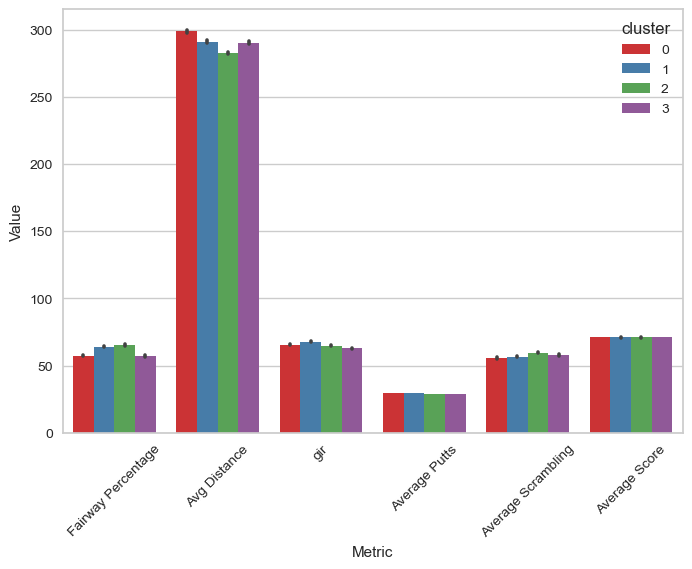

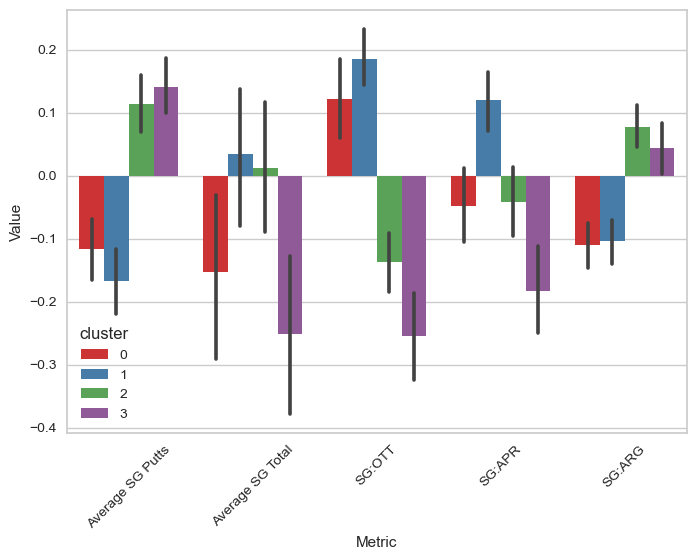

In [228]:
long_temp = pd.melt(temp, id_vars=['cluster'], value_vars=['Fairway Percentage', 'Avg Distance', 'gir',
       'Average Putts', 'Average Scrambling', 'Average Score'],
                  var_name='Metric', value_name='Value')

sns.barplot(data=long_temp, x='Metric', y='Value', hue='cluster', palette="Set1")
plt.xticks(rotation=45) 
plt.show()

long_temp = pd.melt(temp, id_vars=['cluster'], value_vars=['Average SG Putts', 'Average SG Total', 'SG:OTT',
       'SG:APR', 'SG:ARG', 'cluster'],
                  var_name='Metric', value_name='Value')

sns.barplot(data=long_temp, x='Metric', y='Value', hue='cluster', palette="Set1")
plt.xticks(rotation=45)  # Optionally rotate x-axis labels for clarity
plt.show()

<Axes: xlabel='cluster', ylabel='Average Score'>

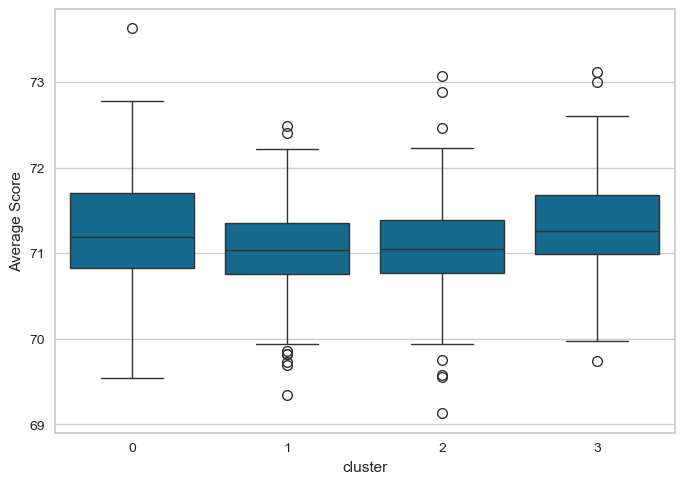

In [227]:
sns.boxplot(data=temp, x="cluster", y="Average Score")

In [225]:
temp.pivot_table(index="cluster", values="No Seasons", aggfunc="mean")

,No Seasons
cluster,
0,3.509259
1,3.669643
2,4.277778
3,3.706522


<Axes: xlabel='cluster', ylabel='Average Score'>

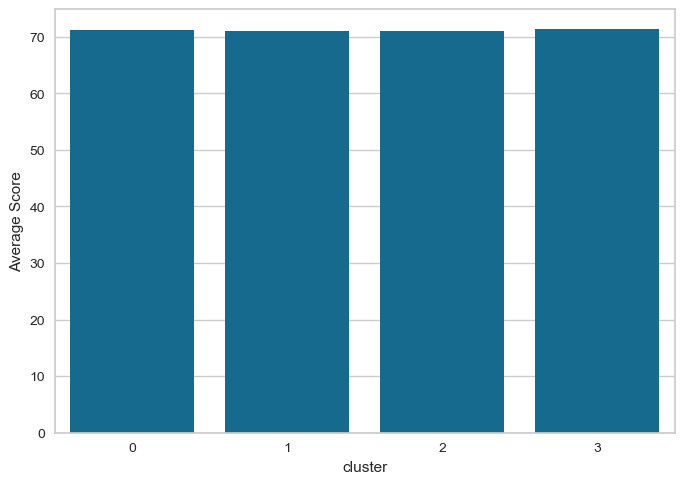

In [222]:
sns.barplot(data=temp, x="cluster", y="Average Score", estimator="mean", errorbar=None)

<Axes: xlabel='cluster', ylabel='Wins'>

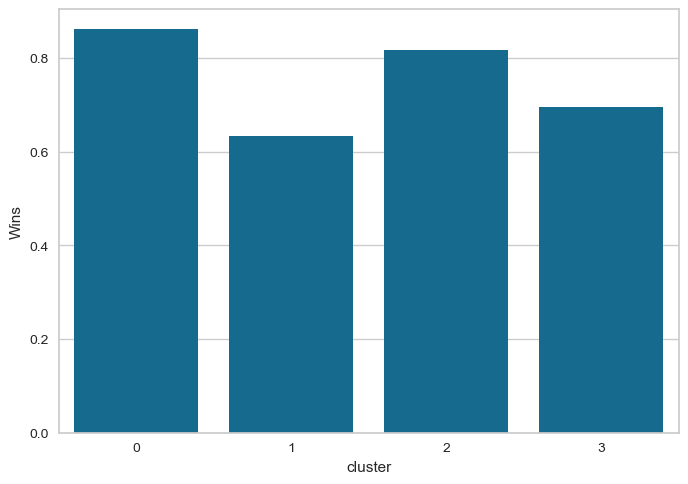

In [226]:
sns.barplot(data=temp, x="cluster", y="Wins", estimator="mean", errorbar=None)

<Axes: xlabel='cluster', ylabel='Money'>

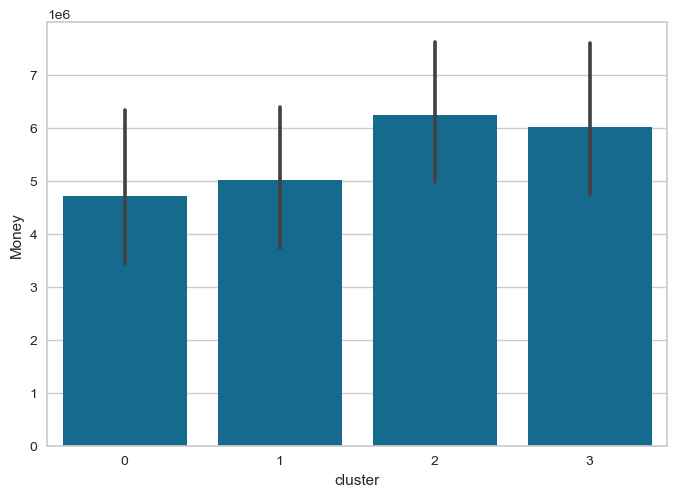

In [208]:
sns.barplot(data=temp, x="cluster", y="Money", estimator="mean")

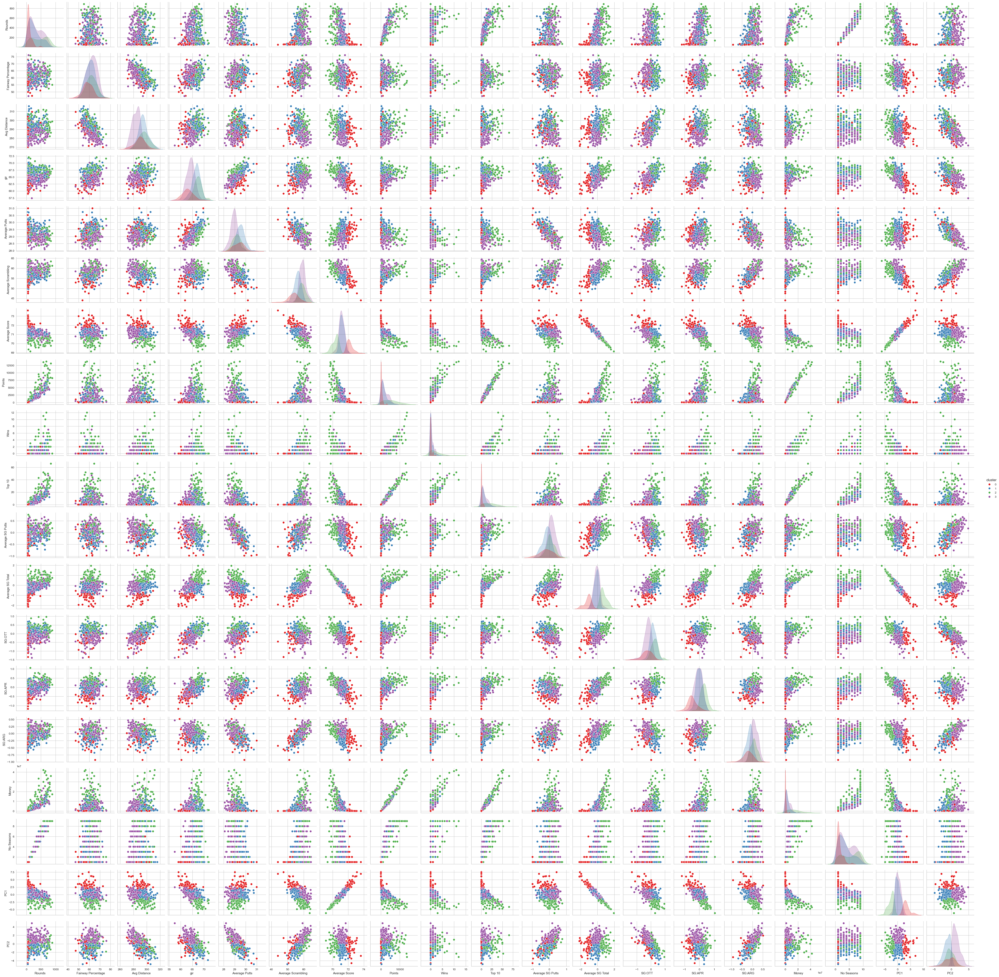

In [54]:
sns.pairplot(data=temp, hue="cluster", palette="Set1")

### 3 PCA

<Axes: xlabel='PC1', ylabel='PC2'>

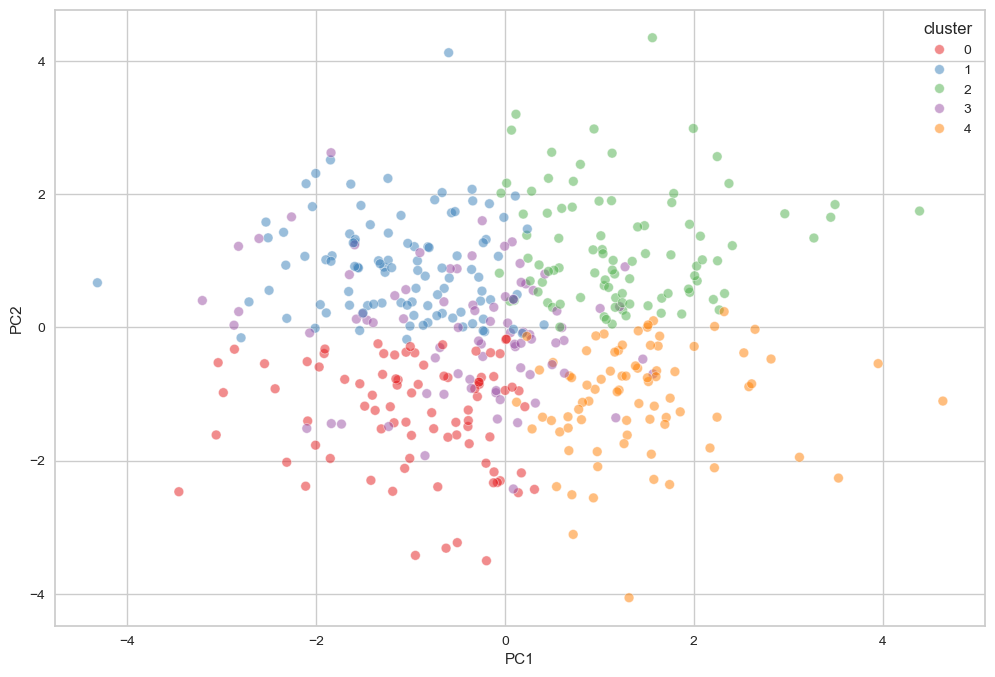

In [182]:
scaler = StandardScaler()
decomp = PCA(n_components=3)
cluster = KMeans(n_clusters=5, n_init=10)
pipe = make_pipeline(scaler, decomp, cluster)

pipe.fit(X)

values = pipe[:2].transform(X)
pca_labels = [f"PC{idx+1}" for idx, i in enumerate(values.T)]

temp3pca = adf.reset_index(drop=True).copy()

pcadf = pd.DataFrame(values, columns=pca_labels)

temp3pca = temp3pca.join(pcadf)

temp3pca["cluster"] = pipe["kmeans"].labels_

plt.figure(figsize=(12,8))
sns.scatterplot(data=temp3pca, x="PC1", y="PC2", hue="cluster", alpha=0.5, palette="Set1")

In [56]:
test = temp3pca.pivot_table(index="cluster", 
        
        values=['Rounds', 'Fairway Percentage', 'Avg Distance',
       'gir', 'Average Putts', 'Average Scrambling', 'Average Score', 'Points', 
       'Average SG Putts', 'Average SG Total', 'SG:OTT',
       'SG:APR', 'SG:ARG', 'Money'], 
        
        aggfunc={'Rounds': "sum", 'Fairway Percentage': "mean", 'Avg Distance': "mean",
       'gir': "mean", 'Average Putts': "mean", 'Average Scrambling': "mean", 
       'Average Score': "mean", 'Points': "sum", 'Average SG Putts': "mean", 
       'Average SG Total': "mean", 'SG:OTT': "mean", 'SG:APR': "mean", 
       'SG:ARG': "mean", 'Money': "sum"})

test

,Average Putts,Average SG Putts,Average SG Total,Average Score,Average Scrambling,Avg Distance,Fairway Percentage,Money,Points,Rounds,SG:APR,SG:ARG,SG:OTT,gir
cluster,,,,,,,,,,,,,,
0,29.548571,-0.158715,-0.115124,71.186409,55.933327,295.842312,60.584566,476827012,223699,34408.0,0.013370,-0.160360,0.190595,66.850881
1,28.839167,0.181917,-0.243090,71.303097,58.629630,286.376651,59.327375,303614219,150849,25625.0,-0.198388,0.095399,-0.321582,63.107226
2,29.463316,-0.221184,-1.195709,72.251551,53.262415,289.822789,58.451803,30849673,15861,5100.0,-0.470003,-0.237985,-0.266362,63.058163
3,29.100474,0.117377,0.822512,70.249087,59.500640,297.598363,60.778182,1136360453,415146,31665.0,0.298543,0.104103,0.303667,67.106591
4,29.197054,0.001842,0.009878,71.048206,59.153088,282.914088,66.032803,504530883,238331,34737.0,0.043894,0.045521,-0.082035,65.841951


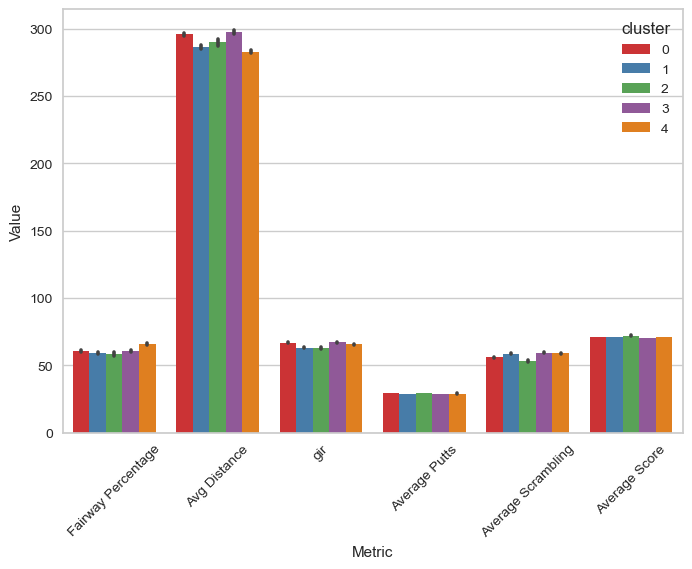

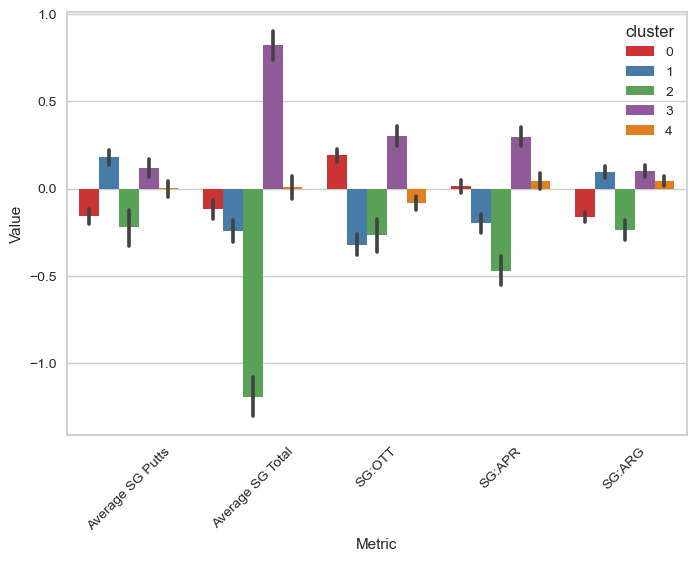

In [57]:
long_temp3pca = pd.melt(temp3pca, id_vars=['cluster'], value_vars=['Fairway Percentage', 'Avg Distance', 'gir',
       'Average Putts', 'Average Scrambling', 'Average Score'],
                  var_name='Metric', value_name='Value')

sns.barplot(data=long_temp3pca, x='Metric', y='Value', hue='cluster', palette="Set1")
plt.xticks(rotation=45) 
plt.show()

long_temp3pca = pd.melt(temp3pca, id_vars=['cluster'], value_vars=['Average SG Putts', 'Average SG Total', 'SG:OTT',
       'SG:APR', 'SG:ARG', 'cluster'],
                  var_name='Metric', value_name='Value')

sns.barplot(data=long_temp3pca, x='Metric', y='Value', hue='cluster', palette="Set1")
plt.xticks(rotation=45)  # Optionally rotate x-axis labels for clarity
plt.show()

<Axes: xlabel='cluster', ylabel='Wins'>

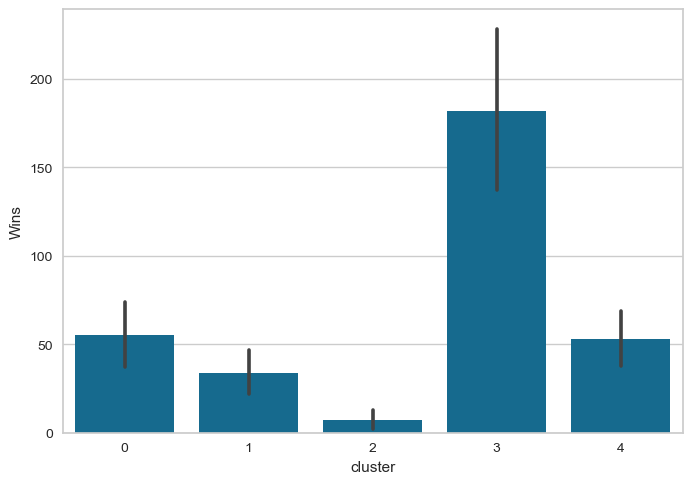

In [58]:
sns.barplot(data=temp3pca, x="cluster", y="Wins", estimator="sum")

<Axes: xlabel='cluster', ylabel='Money'>

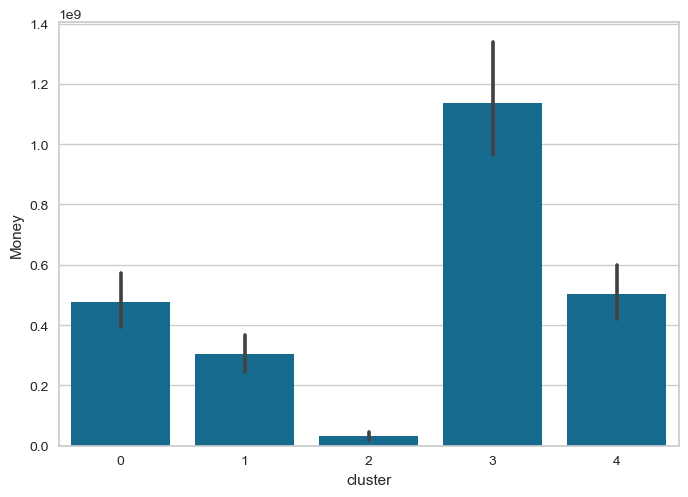

In [59]:
sns.barplot(data=temp3pca, x="cluster", y="Money", estimator="sum")

### 4 PCA - No

In [60]:
scaler = StandardScaler()
decomp = PCA(n_components=4)
cluster = KMeans(n_clusters=5, n_init=10)
pipe = make_pipeline(scaler, decomp, cluster)

pipe.fit(X)

values = pipe[:2].transform(X)
pca_labels = [f"PC{idx+1}" for idx, i in enumerate(values.T)]

temp = df.reset_index(drop=True).copy()

pcadf = pd.DataFrame(values, columns=pca_labels)

temp = temp.join(pcadf)

temp["cluster"] = pipe["kmeans"].labels_

plt.figure(figsize=(12,8))
sns.scatterplot(data=temp, x="PC1", y="PC2", hue="cluster", alpha=0.5, palette="Set1")

ValueError: Length of values (438) does not match length of index (1670)

In [ ]:
test = temp.pivot_table(index="cluster", 
        
        values=['Rounds', 'Fairway Percentage', 'Avg Distance',
       'gir', 'Average Putts', 'Average Scrambling', 'Average Score', 'Points', 
       'Average SG Putts', 'Average SG Total', 'SG:OTT',
       'SG:APR', 'SG:ARG', 'Money'], 
        
        aggfunc={'Rounds': "sum", 'Fairway Percentage': "mean", 'Avg Distance': "mean",
       'gir': "mean", 'Average Putts': "mean", 'Average Scrambling': "mean", 
       'Average Score': "mean", 'Points': "sum", 'Average SG Putts': "mean", 
       'Average SG Total': "mean", 'SG:OTT': "mean", 'SG:APR': "mean", 
       'SG:ARG': "mean", 'Money': "sum"})

test

### 5 PCA - No

In [ ]:
scaler = StandardScaler()
decomp = PCA(n_components=5)
cluster = KMeans(n_clusters=5, n_init=10)
pipe = make_pipeline(scaler, decomp, cluster)

pipe.fit(X)

values = pipe[:2].transform(X)
pca_labels = [f"PC{idx+1}" for idx, i in enumerate(values.T)]

temp = df.reset_index(drop=True).copy()

pcadf = pd.DataFrame(values, columns=pca_labels)

temp = temp.join(pcadf)

temp["cluster"] = pipe["kmeans"].labels_

plt.figure(figsize=(12,8))
sns.scatterplot(data=temp, x="PC1", y="PC2", hue="cluster", alpha=0.5, palette="Set1")

In [ ]:
test = temp.pivot_table(index="cluster", 
        
        values=['Rounds', 'Fairway Percentage', 'Avg Distance',
       'gir', 'Average Putts', 'Average Scrambling', 'Average Score', 'Points', 
       'Average SG Putts', 'Average SG Total', 'SG:OTT',
       'SG:APR', 'SG:ARG', 'Money'], 
        
        aggfunc={'Rounds': "sum", 'Fairway Percentage': "mean", 'Avg Distance': "mean",
       'gir': "mean", 'Average Putts': "mean", 'Average Scrambling': "mean", 
       'Average Score': "mean", 'Points': "sum", 'Average SG Putts': "mean", 
       'Average SG Total': "mean", 'SG:OTT': "mean", 'SG:APR': "mean", 
       'SG:ARG': "mean", 'Money': "sum"})

test

### X-func

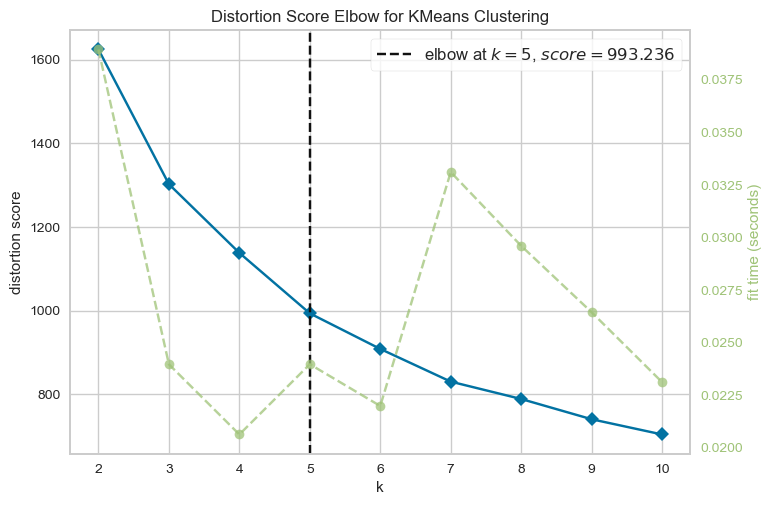

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [149]:
scaler = StandardScaler()
cluster = KElbowVisualizer(KMeans(n_init=10))
pipe = make_pipeline(scaler, cluster)
pipe.fit(X)
pipe[1].show()

In [150]:
scaler = StandardScaler()
cluster = KMeans(n_clusters=5, n_init=10)
pipe = make_pipeline(scaler, cluster)

pipe.fit(X)

tempx = adf.reset_index(drop=True).copy()

tempx["cluster"] = pipe["kmeans"].labels_

#sns.pairplot(data=tempx, hue="cluster", palette="Set1")

In [151]:
test = tempx.pivot_table(index="cluster", 
        
        values=['Rounds', 'Fairway Percentage', 'Avg Distance',
       'gir', 'Average Putts', 'Average Scrambling', 'Average Score', 'Points', 
       'Average SG Putts', 'Average SG Total', 'SG:OTT',
       'SG:APR', 'SG:ARG', 'Money'], 
        
        aggfunc={'Rounds': "sum", 'Fairway Percentage': "mean", 'Avg Distance': "mean",
       'gir': "mean", 'Average Putts': "mean", 'Average Scrambling': "mean", 
       'Average Score': "mean", 'Points': "sum", 'Average SG Putts': "mean", 
       'Average SG Total': "mean", 'SG:OTT': "mean", 'SG:APR': "mean", 
       'SG:ARG': "mean", 'Money': "sum"})

test

,Average Putts,Average SG Putts,Average SG Total,Average Score,Average Scrambling,Avg Distance,Fairway Percentage,Money,Points,Rounds,SG:APR,SG:ARG,SG:OTT,gir
cluster,,,,,,,,,,,,,,
0,28.805592,0.135897,-0.219361,71.284705,58.085348,291.438432,56.586576,388322186,172359,23181.0,-0.168438,0.049392,-0.236114,62.956014
1,29.617136,-0.271964,-0.999022,72.021113,52.679769,290.531891,58.724103,53949037,26157,6375.0,-0.282598,-0.266432,-0.177928,63.825742
2,29.744705,-0.213056,-0.022452,71.087753,56.852164,289.725291,65.448461,340297098,152774,22642.0,0.129848,-0.122336,0.181589,68.188095
3,28.947285,0.137961,0.019898,71.044862,59.660014,282.387980,65.112346,729183110,325212,41469.0,-0.063487,0.085967,-0.140375,64.687415
4,29.281101,0.002824,0.331115,70.751218,57.739139,299.231813,58.928479,940430809,367384,37868.0,0.107372,0.000098,0.222350,66.800470


In [152]:
tempx.columns

Index(['Player Name', 'Rounds', 'Fairway Percentage', 'Avg Distance', 'gir',
       'Average Putts', 'Average Scrambling', 'Average Score', 'Points',
       'Wins', 'Top 10', 'Average SG Putts', 'Average SG Total', 'SG:OTT',
       'SG:APR', 'SG:ARG', 'Money', 'No Seasons', 'cluster'],
      dtype='object')

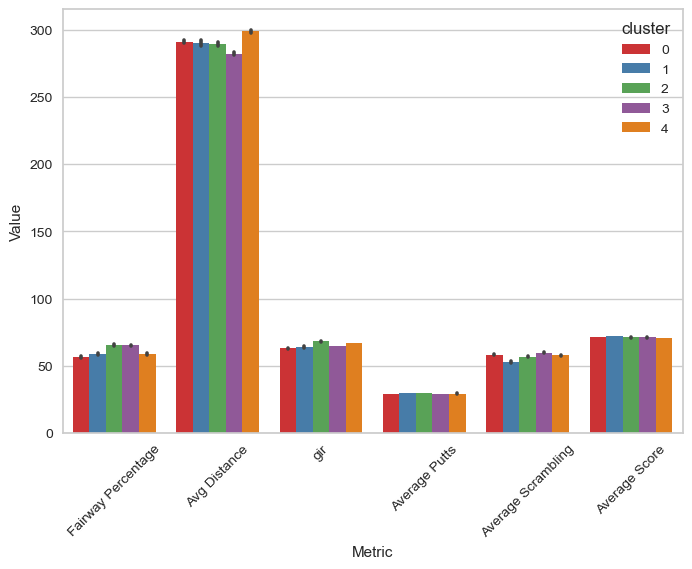

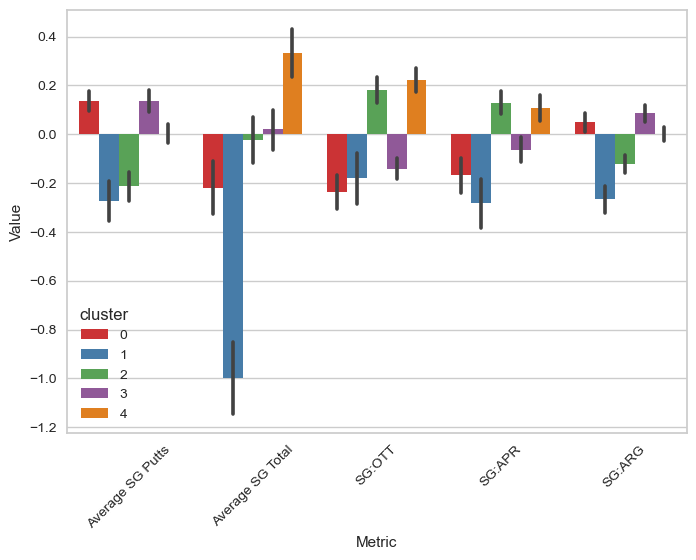

In [153]:
long_tempx = pd.melt(tempx, id_vars=['cluster'], value_vars=['Fairway Percentage', 'Avg Distance', 'gir',
       'Average Putts', 'Average Scrambling', 'Average Score'],
                  var_name='Metric', value_name='Value')

sns.barplot(data=long_tempx, x='Metric', y='Value', hue='cluster', palette="Set1")
plt.xticks(rotation=45) 
plt.show()

long_tempx = pd.melt(tempx, id_vars=['cluster'], value_vars=['Average SG Putts', 'Average SG Total', 'SG:OTT',
       'SG:APR', 'SG:ARG', 'cluster'],
                  var_name='Metric', value_name='Value')

sns.barplot(data=long_tempx, x='Metric', y='Value', hue='cluster', palette="Set1")
plt.xticks(rotation=45)  # Optionally rotate x-axis labels for clarity
plt.show()

<Axes: xlabel='cluster', ylabel='Wins'>

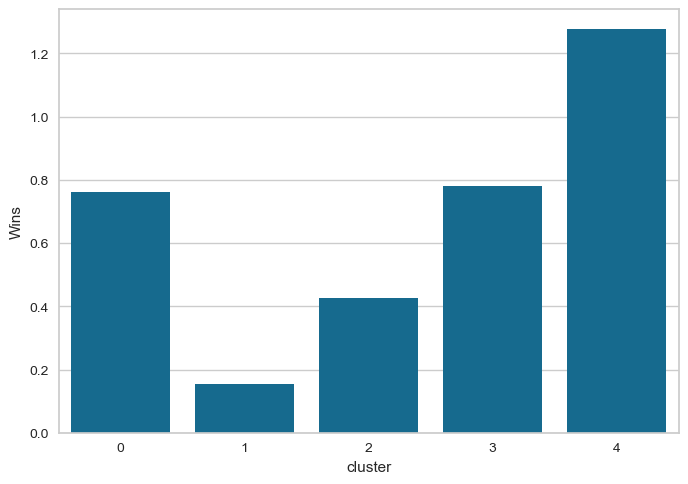

In [154]:
sns.barplot(data=tempx, x="cluster", y="Wins", estimator="mean", errorbar=None)

In [155]:
tempx["cluster"].value_counts()

3    119
4    105
2     82
0     80
1     52
Name: cluster, dtype: int64

<Axes: xlabel='cluster', ylabel='Money'>

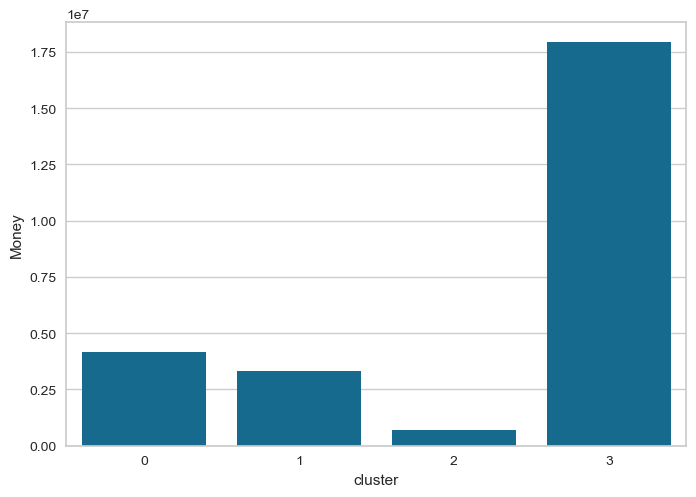

In [119]:
sns.barplot(data=tempx, x="cluster", y="Money", estimator="mean", errorbar=None)

<Axes: xlabel='cluster', ylabel='Top 10'>

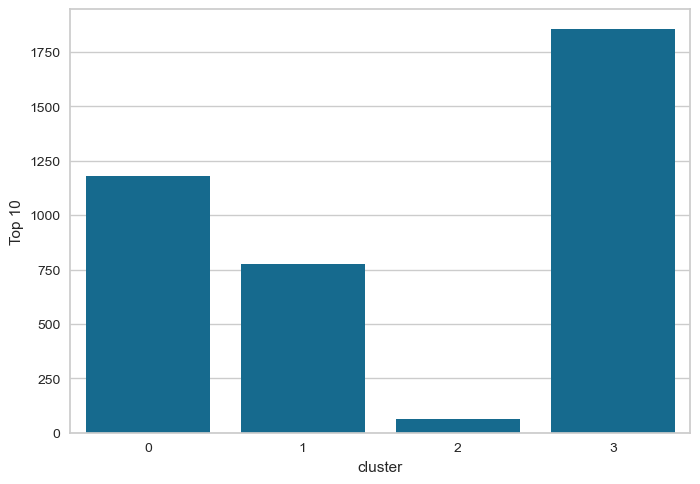

In [117]:
sns.barplot(data=tempx, x="cluster", y="Top 10", estimator="sum", errorbar=None)

## Saving

In [268]:
# For this document, we'll use the PCA

df = temp.copy()

In [273]:
df.drop(columns=["PC1", "PC2"], inplace=True)

In [270]:
df["cluster"] = df["cluster"].map({0: 4, 1: 1, 2: 3, 3: 2}) # Sorting the clusters for easier access
# You can see them as "tiers" based on avg wins per cluster

<Axes: xlabel='cluster', ylabel='Wins'>

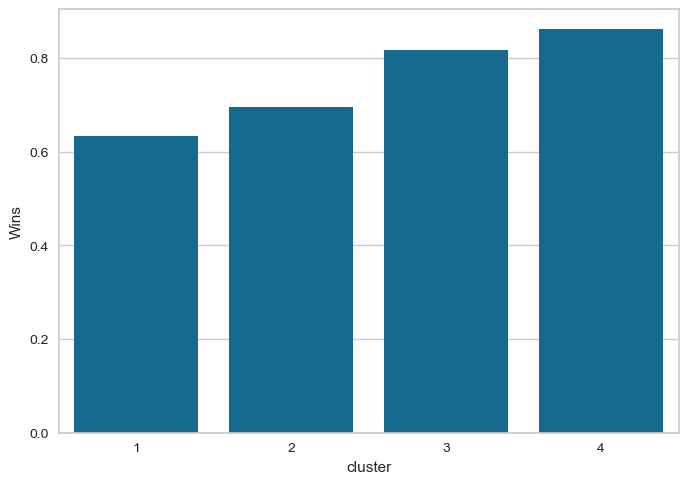

In [274]:
sns.barplot(data=df, x="cluster", y="Wins", estimator="mean", errorbar=None)

In [275]:
# Finished! Saving csvs for explanatory data analysis

df.to_csv((path + '/data/pga_ready_for_eda_pca.csv'), index=False)

In [ ]:
# Ideas
# Top 10, look average placement among clusters (top 10 not)
# Add a binary category for top 10 finishers

KeyError: 'Top 10 Finish'